# COGS 118B - Final Project

# Clustering Techniques for Genre Classification in Spotify

## Group members
- Sreetama Chowdhury
- Lucy Lennemann
- Nikki Rejai
- Melvyn Nam Qiang Tan

# Abstract 
The goal of this project is to address the genre categorization problem in the realm of music, utilizing clustering techniques on the Spotify 1.2M+ Songs dataset. With over 100,000 songs released daily, our objective is to categorize songs into distinct genres based on their audio features, hypothesizing that songs within the same genre share similarities in variables like tempo and danceability. The dataset, comprising 24 variables including danceability, tempo, and acousticness, is sourced from the Spotify API. To understand the data, we plan to dimensionally reduce it using Principal Component Analysis and then visualizing the reduced data using t-SNE and UMAP. After that, we plan to implement K-means clustering, DBSCAN, and Spectral Clustering, comparing their performance using evaluation metrics such as Rand Index and Adjusted Rand Index. Data cleaning involves handling null values, potential one-hot encoding, and standardization. To enhance the user experience on Spotify, personalized recommendations and playlists aligned with individual preferences will be generated based on the identified genres. Success will be measured by the accuracy of the clustering models, evaluated through the Rand Index metrics, providing insights into the effectiveness of our approach in capturing meaningful patterns within the music dataset.

# Background

With the ubiquitous influence of the internet on our daily lives, the wealth of available data continues to increase rapidly. This abundance of data has many benefits as organizations have the opportunity to use this data to optimize their user engagement by understanding user behavior and trends <a name="henke"></a>[<sup>[1]</sup>](#henkenote). Spotify, a leading music streaming platform, has an expansive repository of music-related data, offering insights into popularity of songs and/or artists, users’ music consumption patterns, trends, and song characteristics. The platform hosts an extensive breadth of songs spanning various genres, artists, and musical styles,  prompting an intriguing question: how can we effectively define and categorize this diverse musical library? 

Given the sheer volume of songs available, there is immense potential in classifying tracks into categories, such as musical genres. By classifying the songs on their platform, Spotify can enhance their user experience by providing personalized song recommendations, and playlists, which aligns with individual preferences <a name="zhangjiang"></a>[<sup>[2]</sup>](#zhangjiangnote). Moreover, understanding different nuances and patterns within the dataset can offer valuable insights into user behavior, music trends, and emerging genres. To tackle the complexities presented by the numerous number of variables (more than 16), we will begin with Principal Component Analysis (PCA) for dimensional reduction, followed by t-SNE and UMAP for deeper visualization. After understanding the data from the visualizations, we will then perform classification. 

Our exploration of classification techniques for large datasets led us to consider K-means clustering, Density-Based Spatial Clustering of Applications with Noise (DBSCAN), and Spectral Clustering as potential solutions. K-means is a centroid-based clustering algorithm that partitions the data into K clusters by iteratively updating the cluster centroids to minimize the within-cluster variance<a name="kodinariya"></a>[<sup>[3]</sup>](#kodinariyanote). K-means clustering is a versatile and efficient algorithm that can be used for various clustering tasks, especially when the dataset is very large and the clusters are well-separated. Additionally, we have chosen DBSCAN because of robustness to outliers and noise as well as its ability to detect clusters with irregular shapes makes it well-suited for music data<a name="dbscannote"></a>[<sup>[4]</sup>](#dbscan). Similarly, we have chosen Spectral Clustering because of its applicability to high-dimensional datasets and its ability to detect non-linearly shaped clusters <a name="spectralclusteringnote"></a>[<sup>[5]</sup>](#spectralclustering).  

In this project, we propose to use clustering techniques to group songs and determine song genres based on their audio features. We plan to employ K-means clustering, DBSCAN, and Spectral Clustering algorithms to explore the shape of the dataset and identify clusters representing different musical genres. By utilizing the scikit-learn library in Python, we aim to implement these models and evaluate their accuracy of classifying songs into meaningful genres. Our hypothesis is that clustering techniques, such as K-means, DBSCAN, and Spectral Clustering will be effective in identifying distinct clusters within the Spotify dataset that correspond to different musical genres. We anticipate that these models will provide valuable insights into the structure of the data and enable us to classify songs into genres with a high level of accuracy. Once we have classified the dataset into genres, our goal is to enhance the user experience on Spotify by providing personalized recommendations and curated playlists that cater to individual preferences and interests.


# Problem Statement

Music has always been one of the most popular forms of entertainment, as it can invoke feelings of relaxation and motivation. Because of its popularity, there are more than 100,000 songs released every day which presents a genre categorization problem. In this project, we aim to use clustering techniques with the Spotify 1.2M+ Songs dataset to categorize songs into distinct genres based on their features. We hypothesize that songs in the same genre, such as pop, will have similar values for variables such as tempo and danceability. We will try K-Means clustering, DBSCAN, and Spectral Clustering using metrics such as rand score and adjusted rand score to compare their results. 

# Data

We used the Spotify 1.2M+ Songs dataset <a name="figueroa"></a>[<sup>[6]</sup>](#figueroanote), created by Rodolfo Figueroa using the Spotify API, which we found available on Kaggle. The dataset has over 1.2 million songs and 24 variables. Notable variables include:
- Danceability: values from 0 to 1, with 0 indicating 0 danceability
- Tempo: measured in beats per minute (bpm)
- Acousticness: values from 0 to 1 
- Energy: values from 0 to 1
- Loudness: measured in decibels 
- Valence: values from 0 (extremely negative) to 1 (extremely positive)


In [2]:
import pandas as pd
import numpy as np

# visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go
import plotly.express as px
import plotly.io as pio

import sklearn
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.cluster import DBSCAN, KMeans, SpectralClustering
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import pairwise_kernels
from sklearn.model_selection import GridSearchCV
from sklearn.manifold import TSNE

import umap
import umap.umap_ as umap

# setup plotting in a notebook in a reasonable way
%matplotlib inline
%config InlineBackend.figure_format='retina'
plt.rcParams["figure.figsize"] = [15, 10]
plt.rcParams["font.size"] = 12

We read in data from the full dataset, but extracted a sample of 15000 observations, which is what we've uploaded to the GitHub repo -- the original was too large.

In [3]:
#tracks_features = pd.read_csv('tracks_features.csv')

In [4]:
#tracks_features.shape

In [5]:
# data.to_csv('data.csv', index=False)  

In [6]:
# data = tracks_features.sample(n=15000, random_state=42)
# data = data.reset_index(drop=True)
data = pd.read_csv('data.csv') # data subsample stored here

We drop all observations with missing data (which turns out to be none!) and take a look at the first handful of them, as well as a list of what columns/variables the df contains.

In [6]:
data = data.dropna()
data.shape

(15000, 24)

In [7]:
data.head()

,id,name,album,album_id,artists,artist_ids,track_number,disc_number,explicit,danceability,...,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,year,release_date
0,1aGS6nf2xgv3Xzdob4eOO3,Smokin' Sticky Sticky,Beat'n Down Yo Block,5ZO72kl3xMRRzlpod55k1Q,['Unk'],['0PGtMx1bsqoCHCy3MB3gXA'],15,1,True,0.623,...,0.4020,0.002100,0.000000,0.0691,0.422,87.988,380427,4.0,2006,2006-10-03
1,0fJfoqHIIiET2EcgjOfntG,Holding Back the Years,Holding Back The Years,7sV4kCqQYt8agM5TjkdOYU,['Norm Douglas'],['4kxKyoiYhldUlnfeCZtD0D'],1,1,False,0.585,...,0.0333,0.316000,0.775000,0.0993,0.880,170.082,266520,4.0,2008,2008-06-13
2,0V2R2LC8dR7S0REieXRaGt,All Along The Watchtower - Live - 1991,"Back On The Bus, Y'All",3jmmx4jRkul3POEhn1cgwF,['Indigo Girls'],['4wM29TDTr3HI0qFY3KoSFG'],7,1,False,0.331,...,0.0379,0.709000,0.000000,0.9390,0.430,90.648,383773,4.0,1991,1991-06-04
3,4VUHYLocWOJ2GfvP78AmSs,Windmills,Total Folklore,5PyLkzuxmT6EoVNZCg8Iya,['Dan Friel'],['4HKTPJw50BFASrfhJEHIVP'],2,1,False,0.193,...,0.1090,0.000049,0.838000,0.2850,0.594,113.345,82493,4.0,2013,2013-02-19
4,4m8a1AtmCnoeRzSYoQ0oX0,Overnite Flite,Normal Human Feelings,623VIdYR6Y0NCN9yPbMAC6,['Little Suns'],['5OLcAqMbHpecNOIQyTduQ7'],2,1,False,0.546,...,0.0323,0.427000,0.000105,0.1970,0.424,127.941,230667,1.0,2013,2013-10-08


In [8]:
data.dtypes

id                   object
name                 object
album                object
album_id             object
artists              object
artist_ids           object
track_number          int64
disc_number           int64
explicit               bool
danceability        float64
energy              float64
key                   int64
loudness            float64
mode                  int64
speechiness         float64
acousticness        float64
instrumentalness    float64
liveness            float64
valence             float64
tempo               float64
duration_ms           int64
time_signature      float64
year                  int64
release_date         object
dtype: object

Some exploratory data analysis:
1. Describing the data in terms of measures of central tendency
2. Graphically visualize the distributions of each numerical variable

In [34]:
print(data.info())
print(data.describe())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15000 entries, 0 to 14999
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                15000 non-null  object 
 1   name              15000 non-null  object 
 2   album             15000 non-null  object 
 3   album_id          15000 non-null  object 
 4   artists           15000 non-null  object 
 5   artist_ids        15000 non-null  object 
 6   track_number      15000 non-null  int64  
 7   disc_number       15000 non-null  int64  
 8   explicit          15000 non-null  bool   
 9   danceability      15000 non-null  float64
 10  energy            15000 non-null  float64
 11  key               15000 non-null  int64  
 12  loudness          15000 non-null  float64
 13  mode              15000 non-null  int64  
 14  speechiness       15000 non-null  float64
 15  acousticness      15000 non-null  float64
 16  instrumentalness  15000 non-null  float6

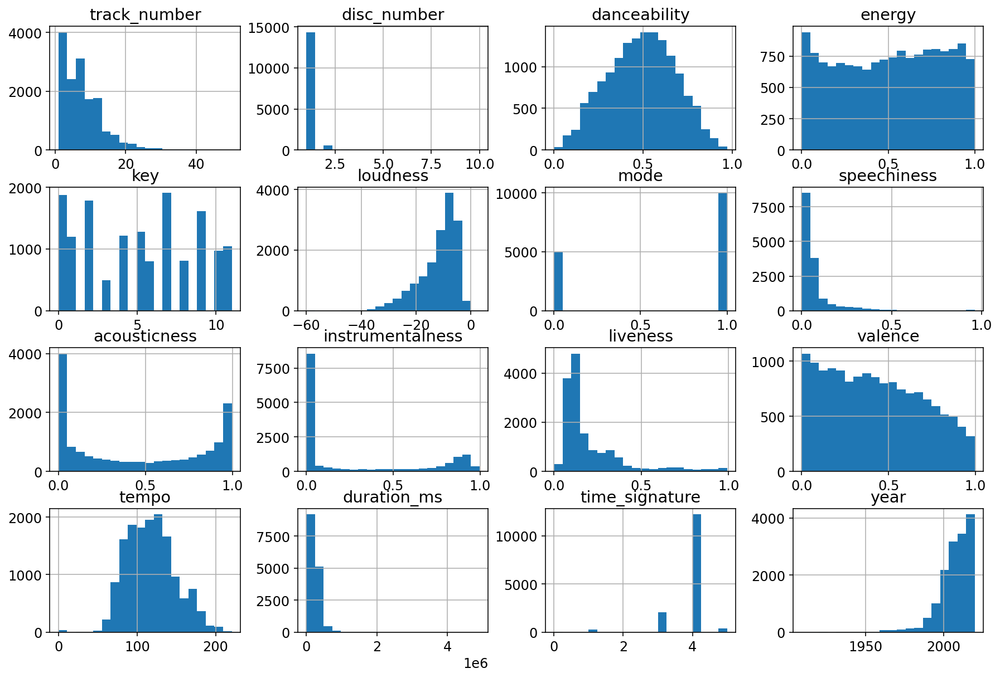

In [35]:
#visualizing distribution of numerical variables
data.hist(bins=20, figsize=(15, 10))
plt.show()

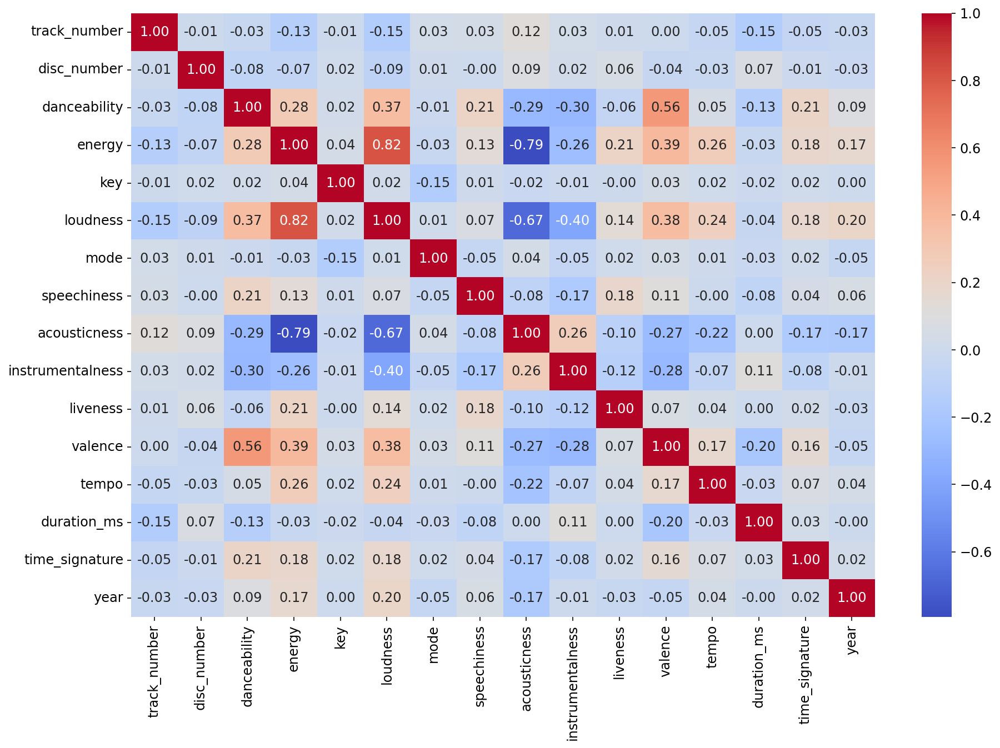

In [36]:
#correlation analysis of numeric variables
numeric_columns = data.select_dtypes(include=['float64', 'int64']).columns
correlation_matrix = data[numeric_columns].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.show()

# Data Visualization: PCA, T-SNE & UMAP
In order to perform PCA, t-SNE or UMAP, we will need to drop non-numerical columns and then scale the numerical columns.

In [8]:
# store some categorical info for hover text later
hover_info = pd.DataFrame(data=[data['name'], data['artists']]).transpose()

# Drop non-numerical or non-ordinal columns
data = data.drop(columns=['name', 'album', 'artists', 'id', 'year', 'release_date', 'artist_ids', 'album_id'])

# Change explicit to be integer type
data['explicit'] = data['explicit'].astype(int)

# Scale the numerical columns
numerical_columns = ['danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness',
                      'liveness', 'valence', 'tempo', 'duration_ms']

scaler = StandardScaler()
data[numerical_columns] = scaler.fit_transform(data[numerical_columns])

## PCA
Since our dataset contains 16 variables/columns, we will use PCA to dimensionally reduce it, thereby making the dataset easier to work with since it will simplify the complexity of our dataset. PCA will transform our original variables into a smaller set of principal components that capture the most significant variance in the data. This will help us with visualizing the dataset and improving the computational efficient when performing t-SNE and UMAP.
These are the steps that we will take to perform PCA:
1. We will fit the PCA transformation to our scaled dataset. We will set n_components as "mle" that will estimate the best number of components to keep.
2. Plot a Scree plot to help us understand the optimal number of prinicipal components to keep. We will use the elbow method to choose the number of components that capture the most variance before it reaches the point of dominishing returns. We will eyeball the best value from the graph.
3. We will plot a cumulative variance plot to visualize the total variance as we include more components.
4. We will print the components of each PC value and interpret the results.

In [9]:
# change matplotlib visualization setting to better display graphs
plt.rcParams["figure.figsize"] = [10, 8]

# plotly defaults
pio.templates.default = "simple_white"
px.defaults.width = 800
px.defaults.height = 550

### Step 1: Fit PCA

In [10]:
# Step 1: Perform PCA
pca = PCA(n_components='mle', svd_solver='full')
# Fit the PCA transformation
pca.fit(data[numerical_columns])
# Transform data
data_pca = pca.transform(data[numerical_columns])

### Step 2: Plot Scree

Explained Variance Ratio: [0.33571656 0.13453561 0.11463454 0.09486981 0.08479915 0.07733143
 0.0747253  0.04090475 0.03077188]


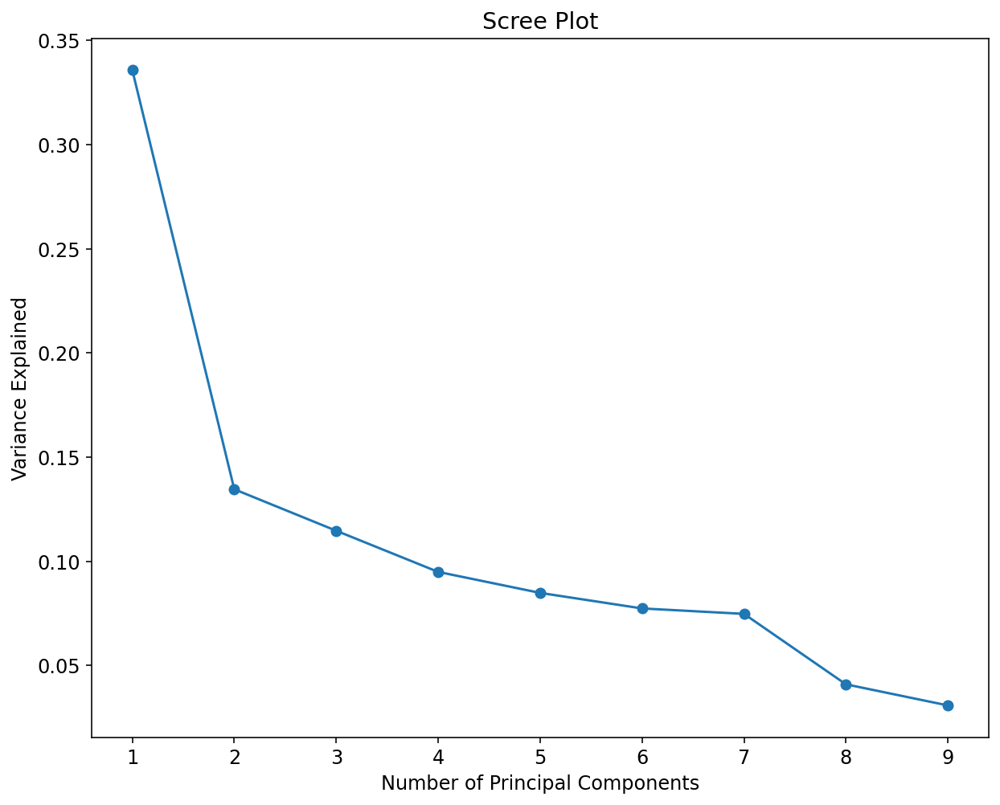

In [12]:
# Step 2: Examine the Output
# Check the explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_
print("Explained Variance Ratio:", explained_variance_ratio)

# Plot the scree plot
plt.figure()
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o')
plt.title('Scree Plot')
plt.xlabel('Number of Principal Components')
plt.ylabel('Variance Explained')
plt.show()

In step 2, we plotted a scree plot that represents the variance vs the number of principal components. We can observe that the first principal component is about 33.57% of the variance, the second principal component is about 13.45%, the third principal component is about 11.46% and so on. Using the elbow method, we can eyeball the point where the rate of decrease in variance sharply changes which is where the number of principal components is equal to 3. We can clearly observe that the variance begins to decrease slowly after the third principal component which is why 3 principal components is the elbow point.

### Step 3: Plot Cumulative Variance

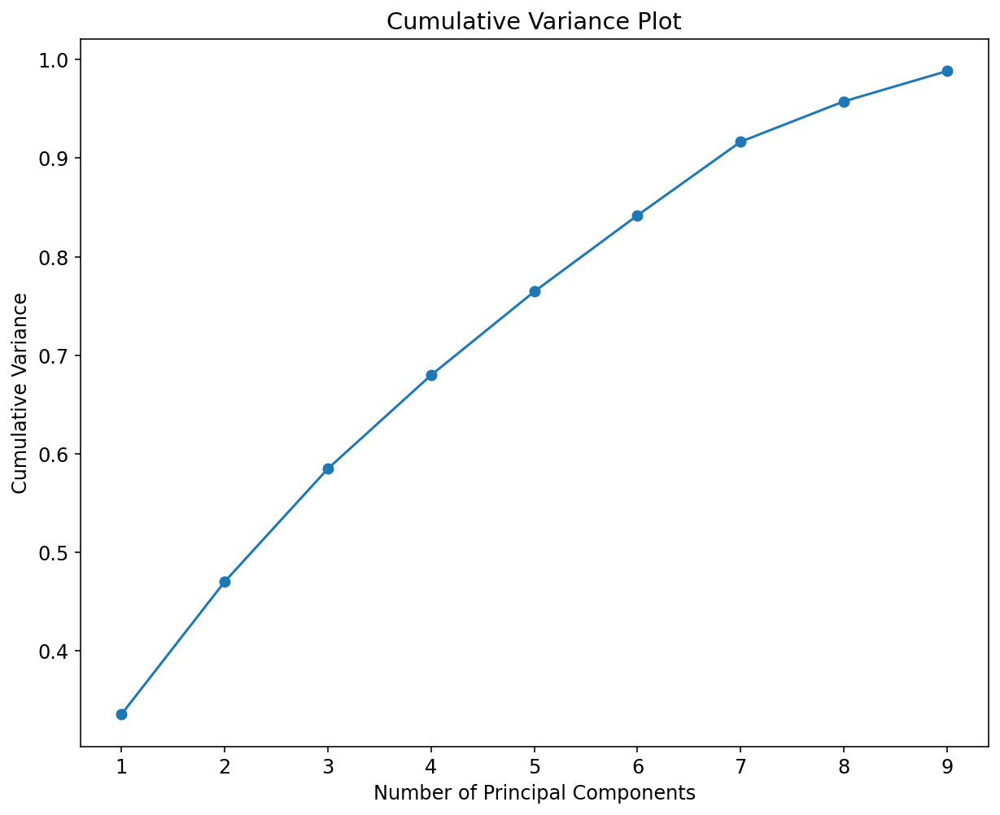

In [13]:
# Step 3: Cumulative variance plot
plt.figure()
plt.plot(range(1, len(explained_variance_ratio) + 1), 
         np.cumsum(explained_variance_ratio), marker='o')
plt.title('Cumulative Variance Plot')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Variance')
plt.show()

In step 3, we plotted a cumulative variance plot to see how increasing the number of principal components affects the cumulative variance. Our chosen principal component value of 3 captures about 60% of the variance. Although capturing more variance is important, the elbow method in the previous step informed us that a principal component value of 3 is most optimal.

### Step 4: Value of PC Components

In [14]:
# Step 4: Value of PC Components
# Check the component loadings (weights)
loadings = pca.components_
# Make it easier to view values by placing in a dataframe
loadings_df = pd.DataFrame(loadings.T, columns=['PC{}'.format(i+1) for i in range(loadings.shape[0])], index=numerical_columns)
print(loadings_df)

                       PC1       PC2       PC3       PC4       PC5       PC6  \
danceability     -0.317407 -0.453700 -0.196160  0.264126  0.228088  0.022590   
energy           -0.472915  0.288258  0.023917  0.014448 -0.108871 -0.224544   
loudness         -0.470282  0.198345 -0.053436  0.082209 -0.152175 -0.020269   
speechiness      -0.131948 -0.323945  0.572971  0.061180  0.453769 -0.477706   
acousticness      0.429650 -0.304565  0.050418 -0.099258  0.126162  0.278090   
instrumentalness  0.283963  0.238955 -0.154506 -0.133142  0.196770 -0.602086   
liveness         -0.119124  0.123816  0.722424 -0.256354 -0.134478  0.314759   
valence          -0.342361 -0.367753 -0.189552 -0.045626  0.148340  0.209022   
tempo            -0.183871  0.232230 -0.195995 -0.657618  0.587540  0.198496   
duration_ms       0.081137  0.460890  0.084517  0.625849  0.516848  0.313767   

                       PC7       PC8       PC9  
danceability      0.232172  0.676704  0.006086  
energy            0.0

In step 4, we printed the value of the 9 PC components to get a better understanding of their values. The values in PC1 tell us that it is negatively influenced by danceability, energy, and loudness. It is however postively influenced by acousticness and instrumentalness which tells us that PC1 captures more acoustic and instrumental types of music such as fold music. Moreover, the values in PC2 show that it is negatively influenced by danceability, speechiness, acousticeness, and valence but is positively influenced by energy, loudness, and duration. This tells us that it captures shorter, louder tracks that are not danceable. Additionally, the values in PC3 tell us that it is negatively influenced by instrumentalness, valence, and tempo but is positively influenced by speechiness and liveliness. This tells us that PC3 captures genres such as rap or even live events where the environment is lively and there is lots of speech. Another good example is PC9 where it is negatively influenced by loudness, energy, and acousticness. This tells us that PC9 captures tracks that are quieter and less acoustic.

### Re-Visualizing the Data

In [44]:
# adding hovertext to help with quantitative analysis later. from plotly docs
# use names, which is a series with the song names of all the datapoints
hovertext=[]
for i in range(0, len(hover_info)):
    hovertext.append('Name: ' + str(hover_info['name'][i]) + '<br>Artist: ' + str(hover_info['artists'][i]))

In [45]:
# Extract the first 3 PCA components
x = data_pca[:, 0]  # PC1
y = data_pca[:, 1]  # PC2
z = data_pca[:, 2]  # PC3

# Create a 3D scatter plot
trace = go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',
    marker=dict(
        size=5,
        opacity=0.5
    ), 
    text=hovertext
)

# Layout for the plot
layout = go.Layout(
    title='3D PCA Plot',
    scene=dict(
        xaxis=dict(title='PC1'),
        yaxis=dict(title='PC2'),
        zaxis=dict(title='PC3'),
    ),
    margin=dict(r=0, b=0, l=0, t=0)
)

# Create and show figure
fig = go.Figure(data=[trace], layout=layout)
fig.show()


From our 3D plot of the first 3 PCA components, we can observe a dominant dense cluster where a lot of data points are closed together. This tells us that many tracks from our 15000 dataset share similar values across the 3 PCA components. There also appears to be outliers that are distant from the main cluster which shows that these tracks do not share any similar values with those tracks in the dense cluster. We can also notice that there is a smaller sub cluster near the dominant cluster which could indicate tracks that share a combination of 2 PCA values but a different third PCA value. Additionally, there could also be possible sub clusters present in the dominant cluster which we will explore later using K-Means and other clustering algorithms.

## t-SNE & UMAP
We will now apply t-SNE and UMAP on data that has been dimensionally reduced using PCA. We have decided to do this because t-SNE and UMAP is computationally expensive and will take a long time to compute on a large dataset like ours. We want the PCA to serve as a noise reduction technique to capture most of the variance. As a result, this would improve the performance of t-SNE and UMAP since there is less noise. Although we initially visualized the first 3 principal components for simplicity, we will use all 9 prinicipal components from PCA for t-SNE and UMAP to retain more of the dataset's variance. We will now perform t-SNE and UMAP on the PCA-reduced data and discuss the findings.

### t-SNE

Let's plot t-SNE for the 9 PCA components with perplexity 40.

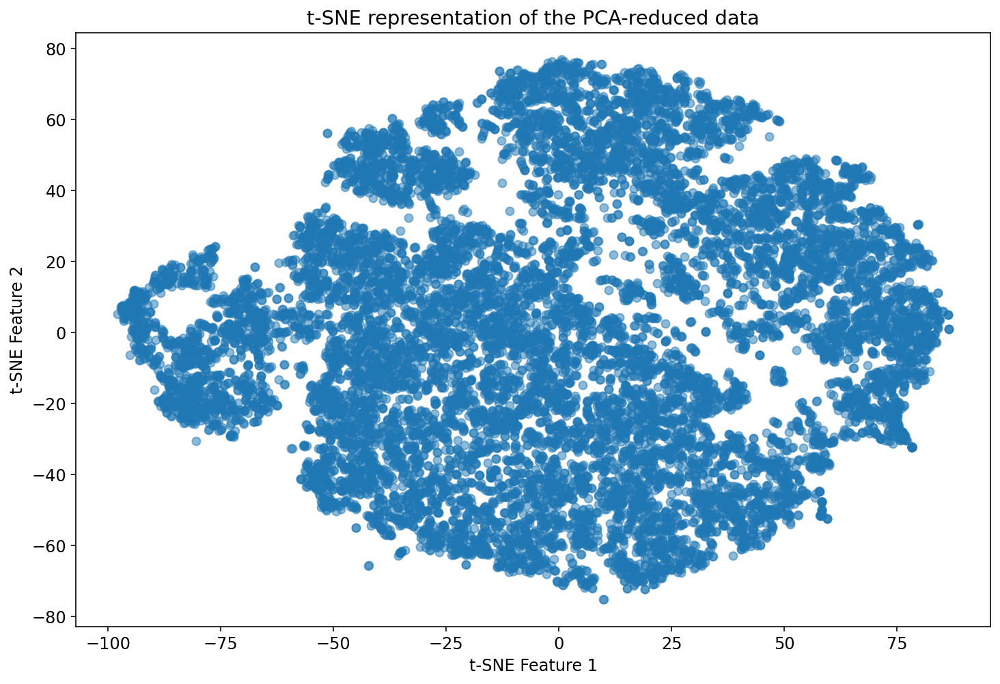

In [46]:
# Apply t-SNE to the PCA-reduced data
tsne = TSNE(n_components=2, perplexity=40, n_iter=1000, random_state=42)
# Using 9 PCA components
data_tsne = tsne.fit_transform(data_pca)

# Plot t-SNE
fig = px.scatter
plt.figure(figsize=(12, 8))
plt.scatter(data_tsne[:, 0], data_tsne[:, 1], alpha=0.5)

plt.xlabel('t-SNE Feature 1')
plt.ylabel('t-SNE Feature 2')
plt.title('t-SNE representation of the PCA-reduced data')
plt.show()

In [47]:
# plotly version of graph to enable hover text
fig = px.scatter(x=data_tsne[:, 0], y=data_tsne[:, 1], title='t-SNE representation of the PCA-reduced data', opacity=0.5,
                 hover_data=[hover_info['name'], hover_info['artists']], 
                labels={'hover_data_0' : 'name', 'hover_data_1' : 'artists'})
fig.show()

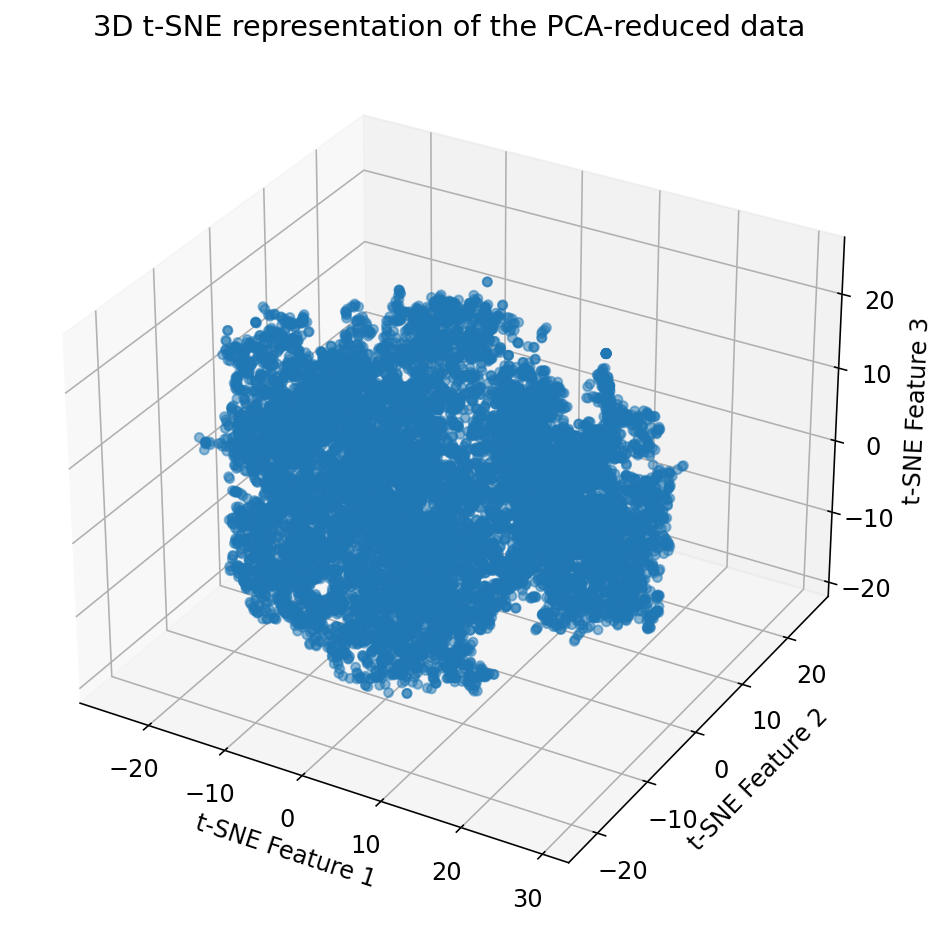

In [129]:
from mpl_toolkits.mplot3d import Axes3D

# Apply t-SNE to the PCA-reduced data to get a 3D view
tsne = TSNE(n_components=3, perplexity=30, n_iter=1000, random_state=42)
data_tsne_3d = tsne.fit_transform(data_pca)

# Plot t-SNE in 3D
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(data_tsne_3d[:, 0], data_tsne_3d[:, 1], data_tsne_3d[:, 2], alpha=0.5)

ax.set_xlabel('t-SNE Feature 1')
ax.set_ylabel('t-SNE Feature 2')
ax.set_zlabel('t-SNE Feature 3')
ax.set_title('3D t-SNE representation of the PCA-reduced data')
plt.show()

From the 2D visualization of t-SNE, we can observe some areas where data points are clustered together. The noticable cluster is the dominant cluster in the middle as well as a smaller cluster to the left of it. There are also 2 medium sized clusters above and to the uppr right of the dominant cluster. Although there are some noticable clusters, it is difficult to determine the actual number of them as some clusters do not have clear gaps between them. The 3D visualization of t-sne also tells us that there are no clear clusters to be distinguished from each other as all the data points are densely clustered in a single cluster.  

Perplexity measures the effective number of local neighbors that each point has and it determines the visualization of clusters. A higher perplexity value will cause t-SNE to consider large local neighborhoods for each point which leads to a global structure of the data in the visualization. Additionally, a higher perplexity will also lead to a loss in the local structure of the data since too much of the data is considered in each point's neighborhood. On the other hand, a low perplexity value will cause t-SNE to focus too much on the local structure and not be able to capture the global structure between clusters. Now, that we know how perplexity works, let's try increasing and reducing the perplexity to see which value gives us the visualization with the most distinguishable clusters that capture local and global structure.

Let's plot t-SNE for the 9 PCA components with perplexity 10.

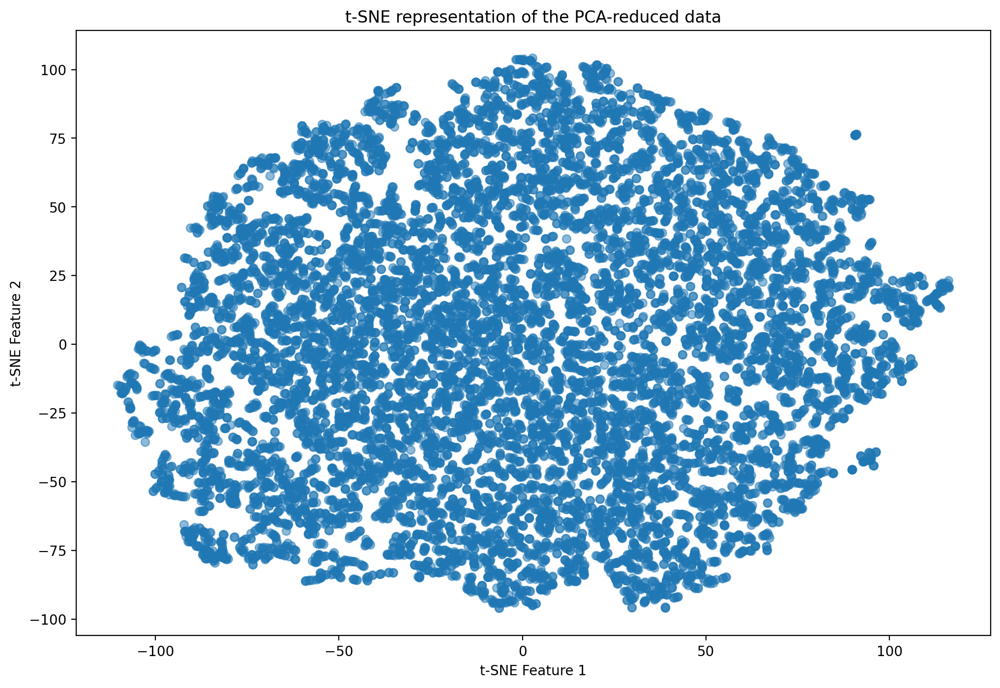

In [33]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# Apply t-SNE to the PCA-reduced data
tsne = TSNE(n_components=2, perplexity=10, n_iter=1000, random_state=42)
# Using 9 PCA components
data_tsne = tsne.fit_transform(data_pca)

# Plot t-SNE
plt.figure(figsize=(12, 8))
plt.scatter(data_tsne[:, 0], data_tsne[:, 1], alpha=0.5)

plt.xlabel('t-SNE Feature 1')
plt.ylabel('t-SNE Feature 2')
plt.title('t-SNE representation of the PCA-reduced data')
plt.show()

From this t-SNE plot, we can clearly see that a perplexity value of 10 takes into account too much of the local structure of the data points. Let's try increasing perplexity to a high value.  

Let's plot t-SNE for the 9 PCA components with perplexity 100.

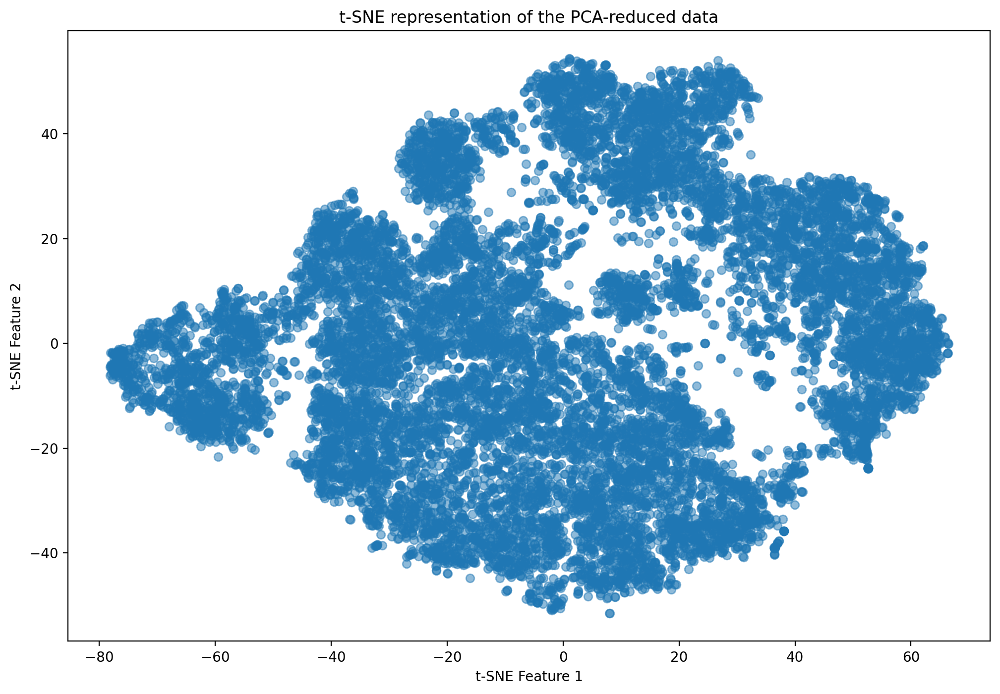

In [34]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# Apply t-SNE to the PCA-reduced data
tsne = TSNE(n_components=2, perplexity=100, n_iter=1000, random_state=42)
# Using 9 PCA components
data_tsne = tsne.fit_transform(data_pca)

# Plot t-SNE
plt.figure(figsize=(12, 8))
plt.scatter(data_tsne[:, 0], data_tsne[:, 1], alpha=0.5)

plt.xlabel('t-SNE Feature 1')
plt.ylabel('t-SNE Feature 2')
plt.title('t-SNE representation of the PCA-reduced data')
plt.show()

This t-SNE plot shows an improvement from the previous plot since the there is now a clearer structure to the clusters. However, it still does not show distinct clusters with clear gaps between them. Let's try decreasing the perplexity and see if the clusters become more apparent.  

Let's plot t-SNE for the 9 PCA components with perplexity 60.

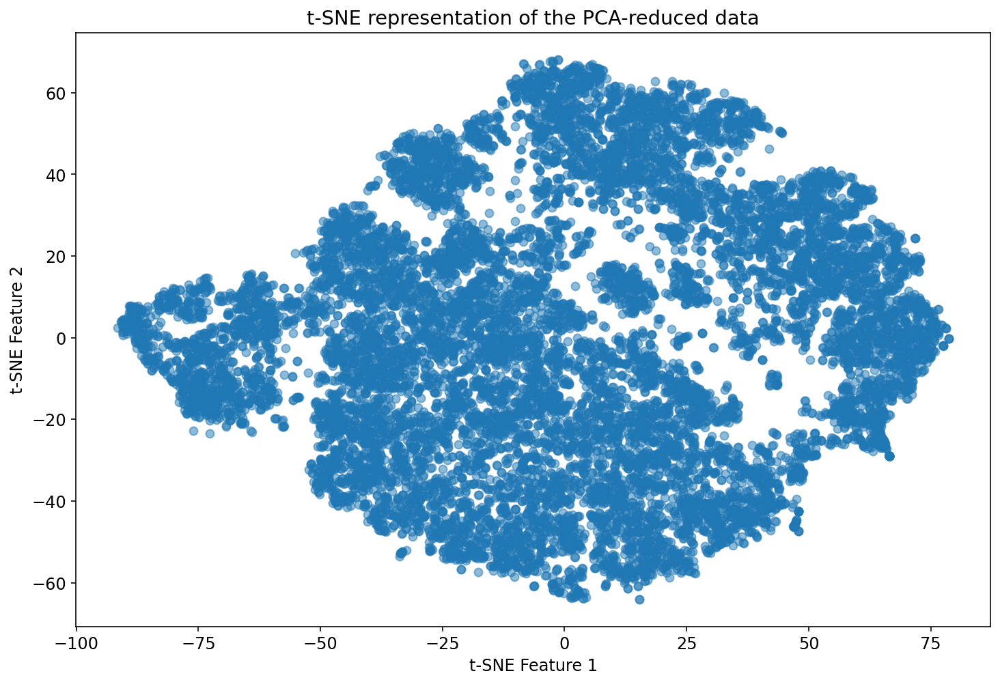

In [48]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# Apply t-SNE to the PCA-reduced data
tsne = TSNE(n_components=2, perplexity=60, n_iter=1000, random_state=42)
# Using 9 PCA components
data_tsne = tsne.fit_transform(data_pca)

# Plot t-SNE
plt.figure(figsize=(12, 8))
plt.scatter(data_tsne[:, 0], data_tsne[:, 1], alpha=0.5)

plt.xlabel('t-SNE Feature 1')
plt.ylabel('t-SNE Feature 2')
plt.title('t-SNE representation of the PCA-reduced data')
plt.show()

This t-SNE plot better visualizes more clusters where there are clear gaps. Although there are still some densely packed clusters with no gaps, I believe that this plot best represents the clusters of our data points.

## UMAP

Let's plot UMAP with n_neighbors 10 and min_dist 0.1.

C:\Users\lucy\anaconda3\lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



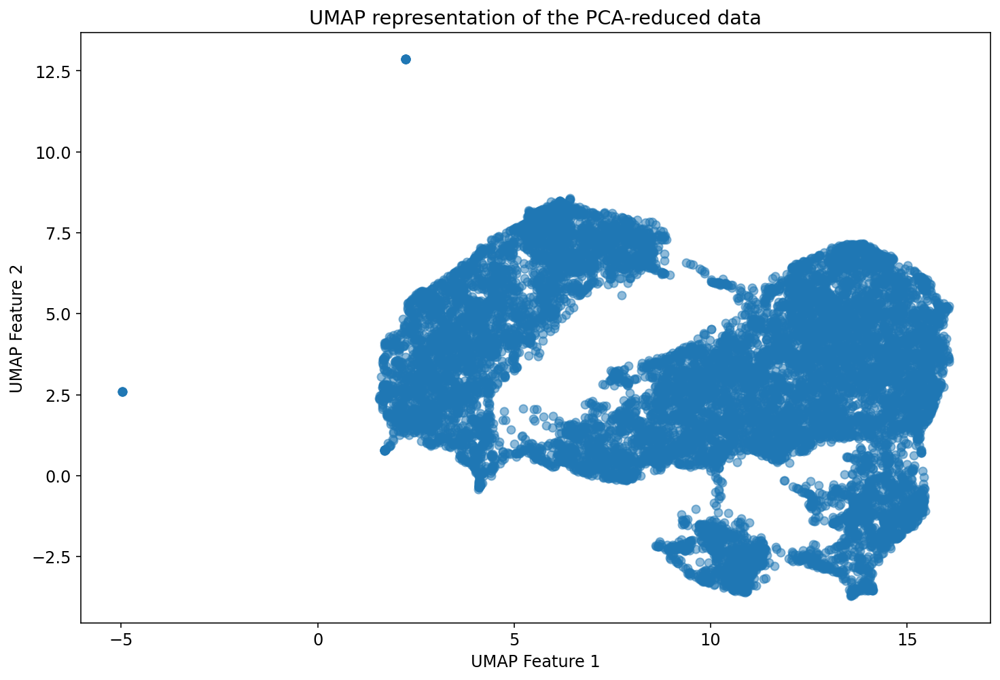

In [132]:
# Apply UMAP to the PCA-reduced data
umap_model = umap.UMAP(n_neighbors=10, min_dist=0.1, n_components=2, random_state=42)
data_umap = umap_model.fit_transform(data_pca)

# Plot the result of the UMAP
plt.figure(figsize=(12, 8))
plt.scatter(data_umap[:, 0], data_umap[:, 1], alpha=0.5)

plt.xlabel('UMAP Feature 1')
plt.ylabel('UMAP Feature 2')
plt.title('UMAP representation of the PCA-reduced data')
plt.show()

The UMAP plot shows a clear global structure of the dataset where there are 2 outliers. The clusters shown in the plot are not isolated and are densely packed. For UMAP, we have 2 hyperparameters to experiment with. The first hyperparameter is n_neighbors and it determines how UMAP will balance the local and global structures of the data. Increasing n_neighbors will reveal more of the global structure and less of the local structure. On the other hand, decreasing n_neighbors will reveal more of the local structure and less of the global structure. The second hyperparameter is min_dist and it affects how dense the clusters are. Increasing min_dist will cause UMAP to spread the data points across the plot and so it will capture more of the global structure and less of the local structure. On the contrary, decreasing min_dist will cause the points to cluster more tightly and so it will capture more of the local structure and less of the global structure.  

Let's try experimenting with different values of n_neighbors and min_dist to see which combinations produces the visualization with distinguishable clusters.  

Let's try plotting the UMP with n_neighbors value 10 and min_dist 0.8.

c:\Python311\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



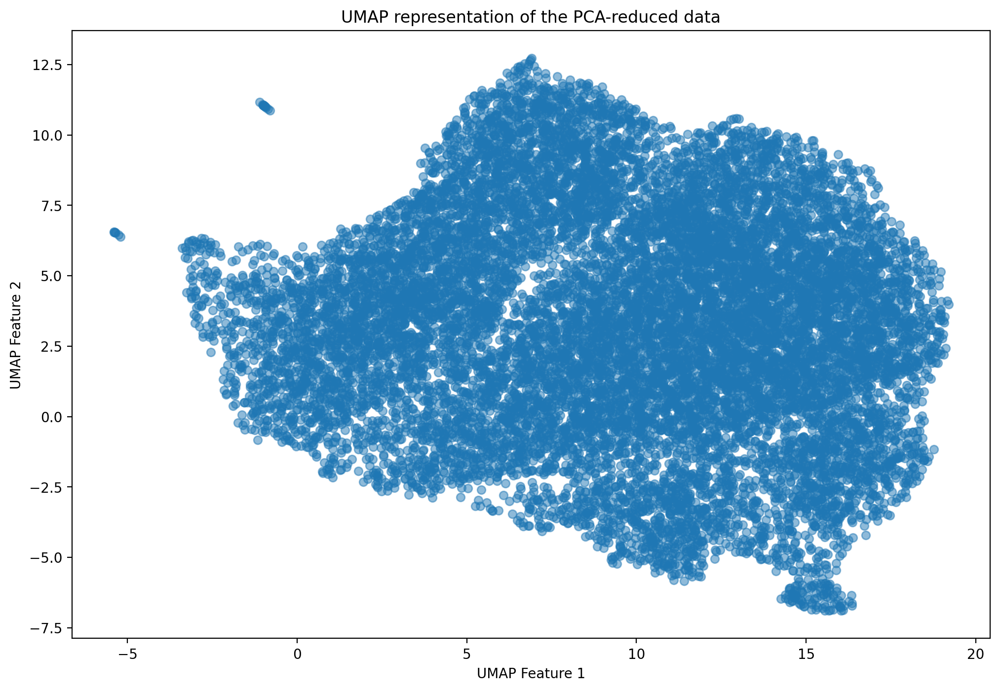

In [76]:
# Apply UMAP to the PCA-reduced data
umap_model = umap.UMAP(n_neighbors=10, min_dist=0.8, n_components=2, random_state=42)
data_umap = umap_model.fit_transform(data_pca)

# Plot the result of the UMAP
plt.figure(figsize=(12, 8))
plt.scatter(data_umap[:, 0], data_umap[:, 1], alpha=0.5)

plt.xlabel('UMAP Feature 1')
plt.ylabel('UMAP Feature 2')
plt.title('UMAP representation of the PCA-reduced data')

plt.show()

After increasing min_dist to 0.8, we can see that the data points are more spread out than before since increasing min_dist causes greater separation between clusters. However, there are still no clear clusters to be seen which tell us that there is strong local similarties across the datapoints. Let's try increasing the number of n_neighbors to capture more of the global structure.  

Let's try plotting the UMP with n_neighbors value 20 and min_dist 0.8.

c:\Python311\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



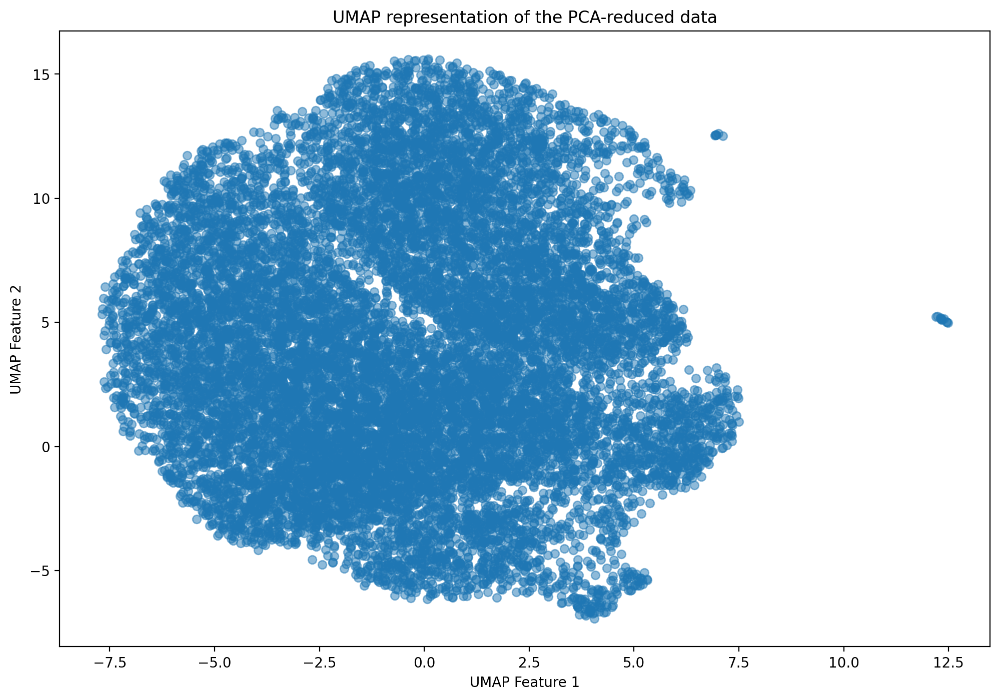

In [81]:
# Apply UMAP to the PCA-reduced data
umap_model = umap.UMAP(n_neighbors=20, min_dist=0.8, n_components=2, random_state=42)
data_umap = umap_model.fit_transform(data_pca)

# Plot the result of the UMAP
plt.figure(figsize=(12, 8))
plt.scatter(data_umap[:, 0], data_umap[:, 1], alpha=0.5)

plt.xlabel('UMAP Feature 1')
plt.ylabel('UMAP Feature 2')
plt.title('UMAP representation of the PCA-reduced data')

plt.show()

The UMAP plot shows no clear clusters since the data points are densly packed together into one dominant cluster. Similar to the previous plots, there are some outliers that are separated from the dominant cluster. Let's try decreasing the min_dist to see if it can capture more of the local structure from this dominant cluster.  

Let's try plotting the UMP with n_neighbors value 20 and min_dist 0.1.

C:\Users\lucy\anaconda3\lib\site-packages\umap\umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


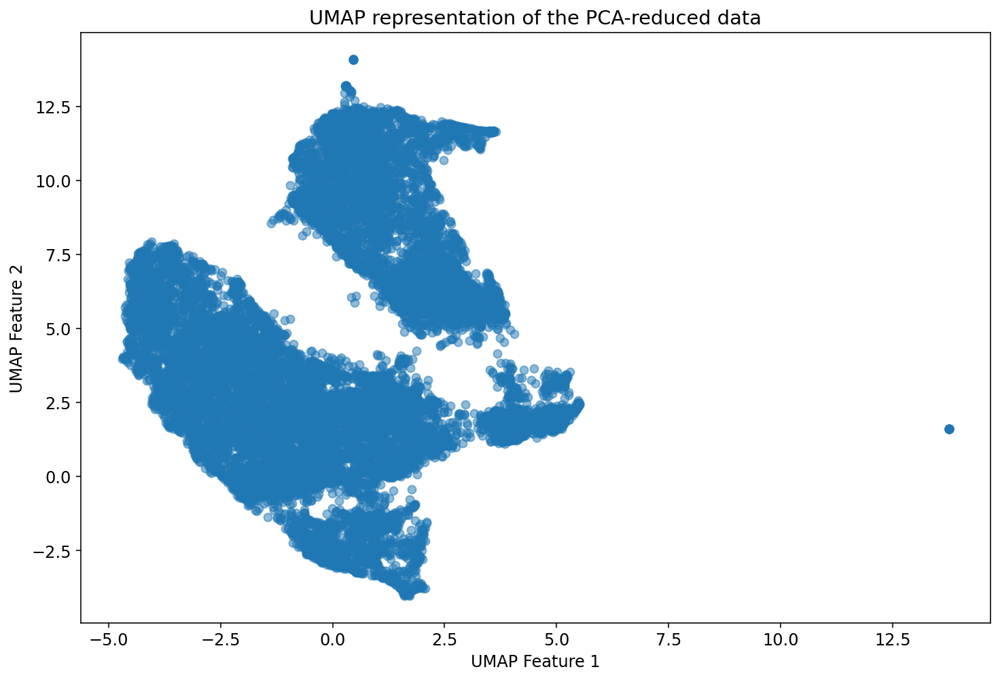

In [18]:
# Apply UMAP to the PCA-reduced data
umap_model = umap.UMAP(n_neighbors=20, min_dist=0.1, n_components=2, random_state=42)
data_umap = umap_model.fit_transform(data_pca)

# Plot the result of the UMAP
plt.figure(figsize=(12, 8))
plt.scatter(data_umap[:, 0], data_umap[:, 1], alpha=0.5)

plt.xlabel('UMAP Feature 1')
plt.ylabel('UMAP Feature 2')
plt.title('UMAP representation of the PCA-reduced data')

plt.show()

The UMAP plot shows 2 dominant clusters with densely packed data points as well as two smaller clusters below them. However, it is difficult to determine if there are any sub clusters within them as they are too tightly packed together with no clear gaps. As a result, it is difficult to determine the best combination of n_neighbors and min_dist to clearly visualize the clusters.

# Clustering Methods
## K-Means Clustering
Performing an exhaustive grid search over various parameter combinations for the KMeans clustering algorithm to find the optimal parameter configuration that maximizes the silhouette score.

In [12]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.model_selection import GridSearchCV

# Define the parameter grid
param_grid = {
    'n_clusters': [3, 4, 5, 6, 7],    # number of clusters to try
    'init': ['k-means++', 'random'],  # method for initialization
    'max_iter': [100, 200, 300],      # max number of iterations for a single run
    'n_init': [10, 20, 30]            # number of times the KMeans algorithm will be run with different centroid seeds
}


# initialize lists to store parameter combinations & silhouette scores
n_cluster_lst = []
init_lst = []
max_iter_lst = []
n_init_lst = []
silhouette_scores = []
max_score = 0
# iterate over each parameter combination
for n_clusters in param_grid['n_clusters']:
    for init in param_grid['init']:
        for max_iter in param_grid['max_iter']:
            for n_init in param_grid['n_init']:
                kmeans = KMeans(n_clusters=n_clusters, init=init, max_iter=max_iter, n_init=n_init)
                
                # fit KMeans to data w curr parameter combination & compute silhouette score
                kmeans.fit(data_pca[:, :3])
                score = silhouette_score(data_pca[:, :3], kmeans.labels_)
                # add params & score to lists
                n_cluster_lst.append(n_clusters)
                init_lst.append(init)
                max_iter_lst.append(max_iter)
                n_init_lst.append(n_init)   
                silhouette_scores.append(score)
                # update max score
                if score > max_score:
                    max_score = score
                    max_n_clusters = n_clusters
                    max_init = init
                    max_max_iter = max_iter
                    max_n_init = n_init
results_df = pd.DataFrame({'n_clusters': n_cluster_lst, 'init': init_lst, 'max_iter':max_iter_lst, 'n_init':n_init_lst ,'silhouette_score': silhouette_scores})
results_df             

,n_clusters,init,max_iter,n_init,silhouette_score
0,3,k-means++,100,10,0.386074
1,3,k-means++,100,20,0.386515
2,3,k-means++,100,30,0.385994
3,3,k-means++,200,10,0.385997
4,3,k-means++,200,20,0.385997
...,...,...,...,...,...
85,7,random,200,20,0.268224
86,7,random,200,30,0.268317
87,7,random,300,10,0.268174
88,7,random,300,20,0.268178


In [16]:
best_kmeans = KMeans(n_clusters=max_n_clusters, init=max_init, max_iter=max_max_iter, n_init=max_n_init)
best_kmeans.fit(data_pca[:, :3])
print(f"Best KMeans Silhouette Coefficient: {silhouette_score(data_pca[:, :3], best_kmeans.labels_):.3f}")

Best KMeans Silhouette Coefficient: 0.386


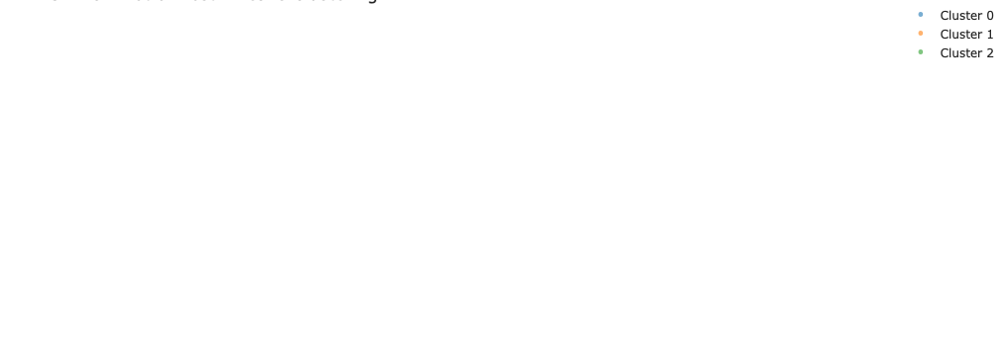

In [15]:
import plotly.graph_objs as go

# Create traces for each cluster
traces = []
for cluster in range(max_n_clusters):
    cluster_data = data_pca[best_kmeans.labels_ == cluster]
    trace = go.Scatter3d(
        x=cluster_data[:, 0],
        y=cluster_data[:, 1],
        z=cluster_data[:, 2],
        mode='markers',
        marker=dict(
            size=5,
            opacity=0.6,
        ),
        name=f'Cluster {cluster}'
    )
    traces.append(trace)

# Create layout
layout = go.Layout(
    title='3D PCA Plot of Best KMeans Clustering',
    scene=dict(
        xaxis=dict(title='PC1'),
        yaxis=dict(title='PC2'),
        zaxis=dict(title='PC3'),
    ),
    margin=dict(r=0, b=0, l=0, t=0),
)

# Create figure
fig = go.Figure(data=traces, layout=layout)

# Show plot
fig.show()

The 3D visualization displays KMeans' ability to disinguish a clear separation of distinct groups within the data, as the grid search found that the optimal parameters for KMeans included n_clusters = 3.

# DBSCAN #

This is density based spatial clustering of applications with noise. Defines clusters as high density areas with low density areas (noise) in betwee. Clusters can be any arbitrary shape. Hyperparameters include eps - which is maximum distance between 2 samples to be considered neighbors to each other - and min_samples - number of samples in a neighborhood for a point to be considered a core point (higher value means more dense). 

Trying DBSCAN with embedding from feature selection that has the most distinct clusters...first let's try t-SNE. 

In [42]:
db_cluster = DBSCAN(eps=3, min_samples=3).fit(data_tsne)
labels = db_cluster.labels_ 
db_cluster

DBSCAN(eps=3, min_samples=3)

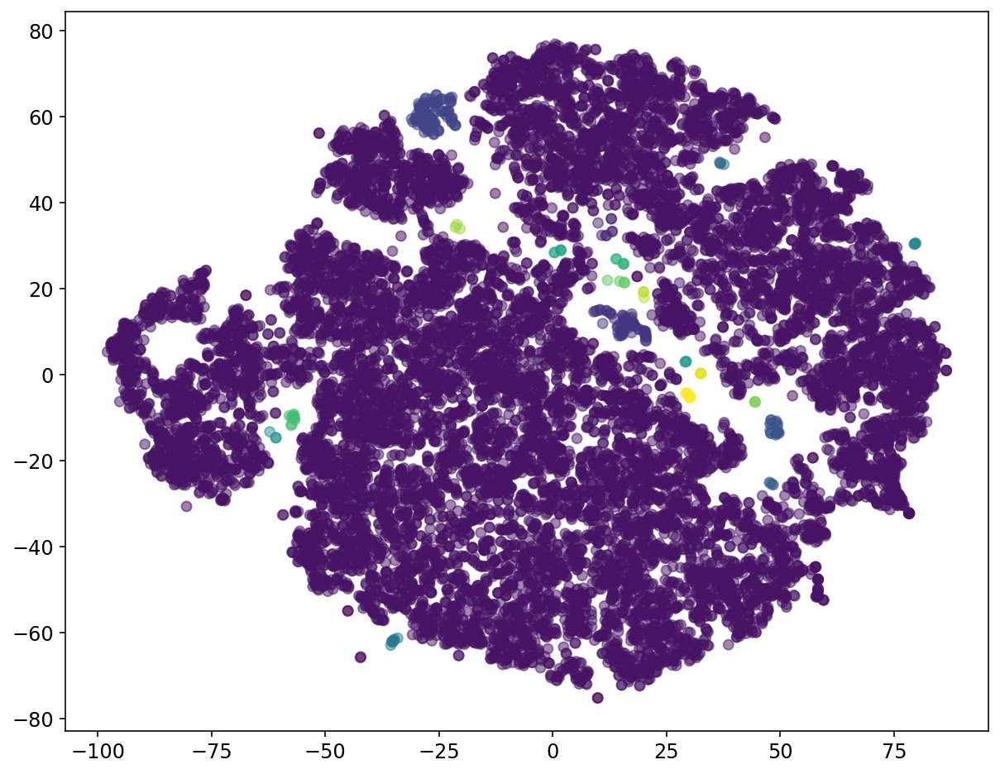

In [44]:
# use tsne representation and color with DBSCAN labels of the clusters
plt.scatter(data_tsne[:, 0], data_tsne[:, 1], alpha=0.5, c=labels)
plt.show()

In [51]:
print(f"Silhouette Coefficient: {silhouette_score(data_tsne, labels):.3f}")

Silhouette Coefficient: 0.063


Some clusters are identified, but most of the datapoints are too close. There's no lower density areas to separate out clusters. Instead, let's try using the UMAP embedding, which is slightly more separated.

In [46]:
db_cluster = DBSCAN(eps=3, min_samples=3).fit(data_umap)
labels = db_cluster.labels_ 

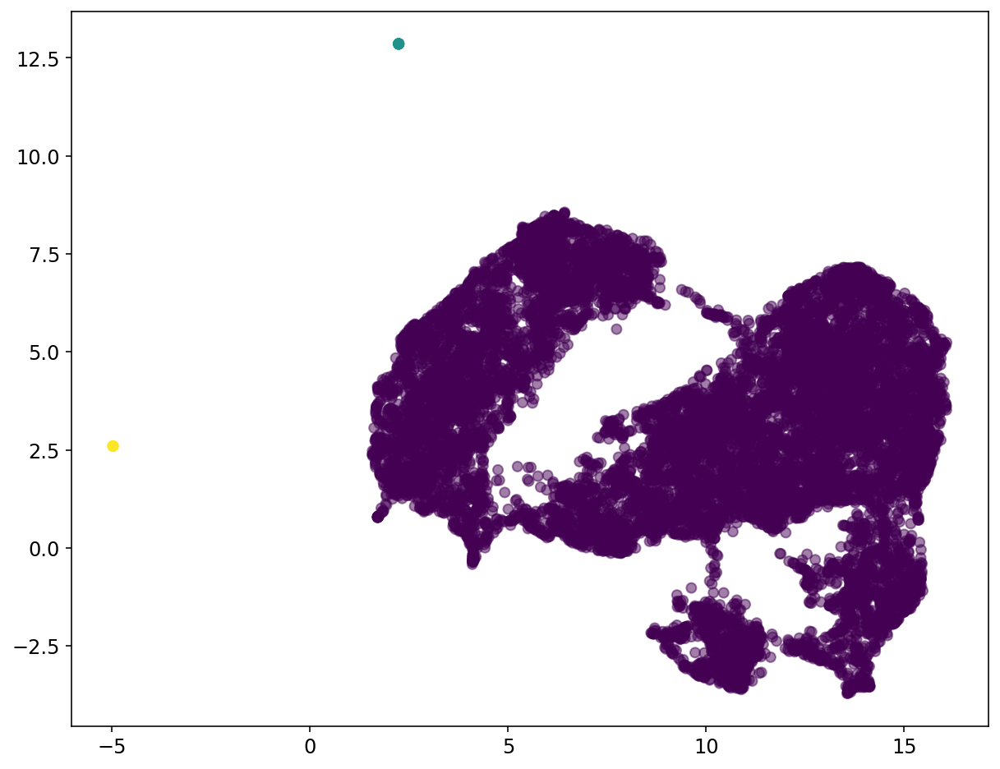

In [47]:
# use tsne representation and color with DBSCAN labels of the clusters
plt.scatter(data_umap[:, 0], data_umap[:, 1], alpha=0.5, c=labels)
plt.show()

In [49]:
print(f"Silhouette Coefficient: {silhouette_score(data_umap, labels):.3f}")

Silhouette Coefficient: 0.432


In conclusion, DBSCAN is not the right method to use. The clusters are not separated by areas of low density, so DBSCAN can't tell what is a cluster and what isn't. This is further exemplified by the low silhouette coefficient scores.

# Spectral Clustering

Let's try another method, spectral clustering, which works well especially for non-convex clusters.

In [52]:
# affinity matrix is default rbf
spect_labels = SpectralClustering(n_clusters=10, assign_labels='cluster_qr', random_state=0).fit_predict(data_umap)

In [53]:
# plotly version of graph to enable hover text
fig = px.scatter(x=data_umap[:, 0], y=data_umap[:, 1], title='Spectral Clustering of Spotify Data, n=10', opacity=0.5,
                 color=spect_labels,
                 hover_data=[hover_info['name'], hover_info['artists']], 
                labels={'hover_data_0' : 'name', 'hover_data_1' : 'artists'})
fig.show()

After doing a qualitative analysis, we hypothesized genres which could correspond to each cluster. We did so by sampling songs from each cluster and noticing common themes within each cluster. Our hypothesis is that 

1. Soundtrack Music (Classical)
    - The King's Thief by Miklos Rozsa
    - Eternal Pine by Chou Wen-chung
2. Rock
    - Love to Hate You by Die Happy 
    - Kiss of Death by Dokken
3. Folk
    - Across the Water by Norman Meehan
    - Times Are Not What They Used To Be by Mo Stroemel
4. Rap
    - Pain by A$AP Rocky & OverDoz.
    - Rosewood by Yung Redd & Lil Ron
5. Latin Music
    - Las Voces by Josh Rouse
    - Te digo vete by Cumbia Latin Band
6. Electronic Dance Music
    - Horizon by Tycho
    - Magnitude Six by Man Machine
7. Neo-Classical Jazz
    - Tin Tin Deo by Dizzy Gillespie 
    - My Kinda Love by Dexter Gordon & Wardell Gray
8. RnB/Pop
    - Anthems by Charli XCX
    - SexBeat by Usher, LilJon, Ludacris
9. Indie 
    - A Good Man's Light Angelo De Augustine
    - Sunday Morning Bird by Girlyman

In our analysis, we observed that the majority of songs within each cluster exhibited consistent genre characteristics, aligning well with our expectations. However, there were instances of outlier songs that seemed to deviate from the predominant genre of their respective clusters. Despite the songs having a range of different popularity, geographic origin, and stylistic elements, spectral clustering demonstrated remarkable efficacy in separating songs into distinct genres within the dataset.

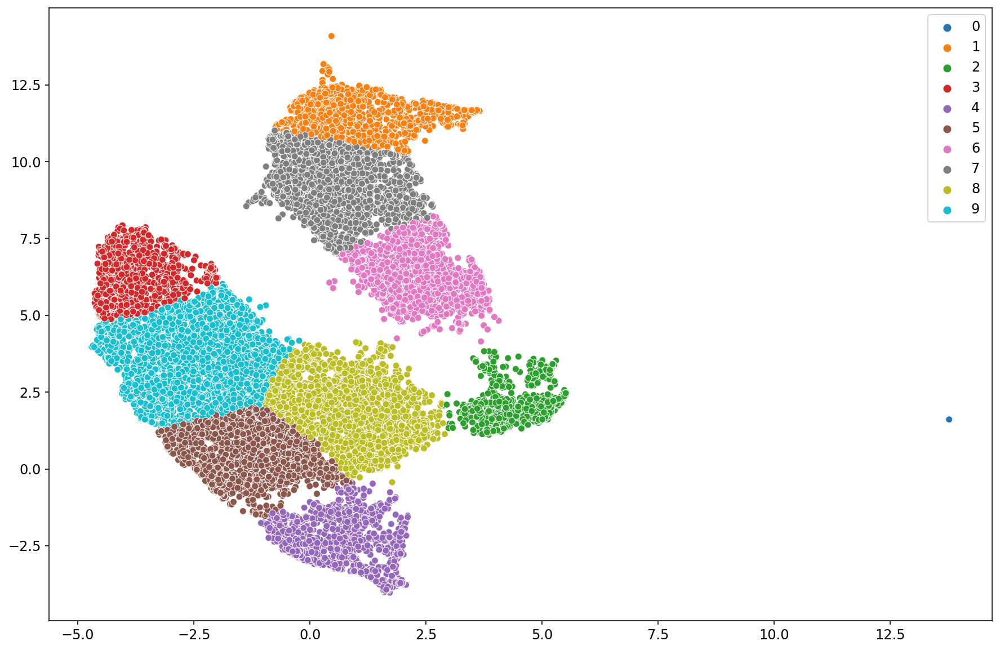

In [54]:
# seaborn version of plot results
sns.scatterplot(data=data_umap, x=data_umap[:, 0], y=data_umap[:, 1], hue=spect_labels, palette="tab10")
plt.show()

In [55]:
print(f"Silhouette Coefficient: {silhouette_score(data_umap, spect_labels):.3f}")

Silhouette Coefficient: 0.434


In [ ]:
# todo: can also plot a silhouette plot for better analysis

Run cross validation to see the right number of clusters to pick for spectral clustering...

In [62]:
from sklearn.metrics import make_scorer

def silhouette_scoring(estimator, X, y):
    predictions = estimator.fit_predict(X)
    return silhouette_score(y, predictions)

silhouette_scorer = make_scorer(silhouette_score)
spect = SpectralClustering(assign_labels='cluster_qr', random_state=0)

param_grid = {
    "n_clusters": [10]
}

grid = GridSearchCV(
    estimator=spect,
    param_grid=param_grid,
    scoring=silhouette_scorer,
    verbose=3,
    n_jobs=-1,  # Run in parallel
    cv=3
)

In [ ]:
# fit the grid with the training data
# this will take considerable amount of time.
fitted = grid.fit(data_umap) 

Fitting 3 folds for each of 1 candidates, totalling 3 fits


In [61]:
fitted.cv_results_

{'mean_fit_time': array([990.60310903, 710.51450653]),
 'std_fit_time': array([ 54.0125519 , 409.69232933]),
 'mean_score_time': array([0.12580848, 0.0725472 ]),
 'std_score_time': array([0.13567482, 0.06258437]),
 'param_n_clusters': masked_array(data=[3, 4],
              mask=[False, False],
        fill_value='?',
             dtype=object),
 'params': [{'n_clusters': 3}, {'n_clusters': 4}],
 'split0_test_score': array([nan, nan]),
 'split1_test_score': array([nan, nan]),
 'split2_test_score': array([nan, nan]),
 'split3_test_score': array([nan, nan]),
 'split4_test_score': array([nan, nan]),
 'mean_test_score': array([nan, nan]),
 'std_test_score': array([nan, nan]),
 'rank_test_score': array([1, 1])}

In [17]:
# alt way to do model selection
n_clusters = [10, 20]
# n_clusters 4, silhouette score: 0.41030660112162143
#n_clusters 7, silhouette score: 0.25327376118458705
# n_clusters 10, silhouette score: 0.24424177805987018
# n_clusters 20, silhouette score: 0.1531012362623862

for i in range(0, len(n_clusters)):
  spect_labels = SpectralClustering(assign_labels='cluster_qr', random_state=0, n_clusters=n_clusters[i]).fit_predict(data_pca)
  score = silhouette_score(data_pca, spect_labels)
  print('n_clusters ' + str(n_clusters[i]) + ", silhouette score: " + str(score))

n_clusters 10, silhouette score: 0.24424177805987018
n_clusters 20, silhouette score: 0.1531012362623862


In [22]:
# now with umap embedding 
n_clusters = [4, 7, 10, 20]
affinity = ['nearest_neighbors', 'rbf']

for i in range(0, len(n_clusters)):
  for j in range(0, len(affinity)):
    spect_labels = SpectralClustering(assign_labels='cluster_qr', random_state=0, n_clusters=n_clusters[i],
                                      affinity=affinity[j]).fit_predict(data_umap)
    score = silhouette_score(data_umap, spect_labels)
    print('n_clusters ' +  str(n_clusters[i]) + ", affinity: " + str(affinity[j]) + ", silhouette score: " + str(score))

C:\Users\lucy\anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


n_clusters 4, affinity: nearest_neighbors, silhouette score: 0.46358296
n_clusters 4, affinity: rbf, silhouette score: 0.41167408


C:\Users\lucy\anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


n_clusters 7, affinity: nearest_neighbors, silhouette score: 0.44483522
n_clusters 7, affinity: rbf, silhouette score: 0.45543715


C:\Users\lucy\anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


n_clusters 10, affinity: nearest_neighbors, silhouette score: 0.4270293
n_clusters 10, affinity: rbf, silhouette score: 0.43357706


C:\Users\lucy\anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


n_clusters 20, affinity: nearest_neighbors, silhouette score: 0.35537645
n_clusters 20, affinity: rbf, silhouette score: 0.37358105


# Evaluation Metrics

Propose at least one evaluation metric that can be used to quantify the performance of both the benchmark model and the solution model. The evaluation metric(s) you propose should be appropriate given the context of the data, the problem statement, and the intended solution. Describe how the evaluation metric(s) are derived and provide an example of their mathematical representations (if applicable). Complex evaluation metrics should be clearly defined and quantifiable (can be expressed in mathematical or logical terms).

# Proposed Solution

We propose to use clustering techniques to group the songs and determine song genres based on our variables, such as tempo and valence. We plan to use the K-means and Gaussian Mixture Model (GMM) algorithms to explore patterns in the dataset, cluster the data, and determine whether these clusters accurately represent the genres in the dataset. As we don’t know whether the data has spherical shape or a different shape, we will try both clustering algorithms to see which model is more optimal. We will implement these models with the Python library scikit-learn.

We may use PCA to reduce the number of variables. We will also perform model selection by performing the rand score and adjusted scores for both models to determine the best model. For each individual model, we will adjust the hyperparameters. For example, for K-means, we will use silhouette scores and plot the distortion measure to see which value of k gives the best results. We will then analyze the clustering results to evaluate the performance of each model in grouping songs into their correct genres and assess the interpretability of the clusters generated by each algorithm.

# Discussion

### Interpreting the result

OK, you've given us quite a bit of tech informaiton above, now its time to tell us what to pay attention to in all that.  Think clearly about your results, decide on one main point and 2-4 secondary points you want us to understand. Highlight HOW your results support those points.  You probably want 2-5 sentences per point.



### Limitations

One limitation of our work — something we'd do more research on and try to figure out if we had more time or if we chose to extend this project in the future — is the use of categorical variables to do PCA. When we first started preprocessing our data we noted a number of categorical variables within the dataset alongside the the many numerical variables we had planned to consider, so we tried to one-hot encode them. The result of this was an incredibly massive set of features — variables like artist name and album name, once encoded, ballooned in size until the size of the matrix became computationally too expensive to work with. We ended up discarding those categorical variables and only using the numerical ones. A member of the instructional team told us that if we wanted to use categorical variables to do PCA with in a manageable way it might be worth looking into MCA (Multiple Correspondence Analysis), which would be an area of future work, potentially.

### Ethics & Privacy
In this section, we will discuss the ethics and data privacy that will be associated with our data science project. We will address and provide solutions to mitigate the key areas which include user consent and anonymity, transparency in data use and analysis techniques, compliance with data protection laws and data equality.

In our project, we will ensure that the data has been collected with the users’ consent where the data is anonymized. Sensitive information such as names, user IDs, and other personal information that could distinguish the user will be removed. By doing this, we will have protected the users’ individual privacy from potential cyber attacks and misuse. In regards to our dataset, the data was collected by Spotify where the features were derived from officially published music, so there's not too much to worry about with regard to privacy or personal data. If, however, relevant data that described the listening habits of the people streaming these songs was pulled and used, that would be a much bigger issue: we'd have to make sure the people whose data was being collected a) knew and consented to the collection in the first place and b) consented to their data being used to train ML models.

To foster transparency, we will be clear in the purpose of our data analysis as well as maintain a clear documentation of what the data is being used for as well as for what purposes. Likewise, the algorithms and clustering techniques that we employ will also be well documented so that it can be recreated in the future to ensure trust and transparency in our findings.

Compliance with data protection laws is also an important aspect that we will address. We will ensure that the data is in compliance with data protection laws and also allow users the right to request their data be removed from the database. This will help to ensure our practices are in line with current legal standards and at the same time protecting user data.

To address potential biases, we will thoroughly look through and analyze the data’s natural distribution. We will use graphical techniques to identify any imbalances which could lead to skewed results and unfair representations. Additionally, we can also make sure that the dataset includes a diverse range of music genres and artists to promote fairness and prevent skewed outcomes.

Lastly, we will ensure that our results will not affect user behavior such as how it could contribute to increased screen time or usage addiction. To mitigate this, we will promote healthy usage such as incorporating usage limit reminders.


### Conclusion

Reiterate your main point and in just a few sentences tell us how your results support it. Mention how this work would fit in the background/context of other work in this field if you can. Suggest directions for future work if you want to.

# Footnotes
<a name="henkenote"></a>1.[^](#henke): Henke, Nicolaus, et al. THE AGE OF ANALYTICS: COMPETING IN A DATA-DRIVEN WORLD, McKinsey Global Institute, Dec. 2016, [dln.jaipuria.ac.in:8080/jspui/bitstream/123456789/2898/1/MGI-Reinventing-Construction-Full-report.pdf.](dln.jaipuria.ac.in:8080/jspui/bitstream/123456789/2898/1/MGI-Reinventing-Construction-Full-report.pdf.)<br> 
<a name="zhangziangnote"></a>2.[^](#zhangziang): Zhang, Ziang, and Jingbo Chang. “Clustering-Based Categorization of Music Users through Unsupervised Learning.” Economics & Management Information, 30 Dec. 2022, [doi.org/10.58195/emi.2022.1006](doi.org/10.58195/emi.2022.1006)<br>
<a name="kodinariyanote"></a>3.[^](#kodinariya): Kodinariya, Trupti M, and Prashant R. Makwana. “Review on Determining Number of Cluster in K-Means Clustering.” International Journal of Advance Research in Computer Science and Management Studies, Nov. 2013, [www.researchgate.net/publication/313554124_Review_on_Determining_of_Cluster_in_K-means_Clustering](www.researchgate.net/publication/313554124_Review_on_Determining_of_Cluster_in_K-means_Clustering).<br>
<a name="dbscannote"></a>4.[^](#dbscan): "DBSCAN." Wikipedia, Wikimedia Foundation, [https://en.wikipedia.org/wiki/DBSCAN](https://en.wikipedia.org/wiki/DBSCAN). <br>
<a name="spectralclusteringnote"></a>5.[^](#spectralclustering): "Spectral Clustering." Wikipedia, Wikimedia Foundation, [en.wikipedia.org/wiki/Spectral_clustering](https://en.wikipedia.org/wiki/Spectral_clustering). <br>
<a name="figueroanote"></a>6.[^](#figueroa): Figueroa, Rodolpho. Spotify 1.2M+ Songs. (1). [https://www.kaggle.com/datasets/rodolfofigueroa/spotify-12m-songs/data](https://www.kaggle.com/datasets/rodolfofigueroa/spotify-12m-songs/data). 